# Sampling Methods

`Sampling` is a special technique of data transformation, which is built into Lets-Plot and is applied after `stat` transformation. 

Sampling helps working with large datasets when unintentional attempt to plot an excessively large number of geometries can lead  
to UI freezes and even to out-of-memory crashes. Sampling is also one of the ways of handling over-plotting.

1. [Random Sampling](#1.-Random-Sampling)

2. [Systematic Sampling](#2.-Systematic-Sampling)

3. [Pick Sampling](#3.-Pick-Sampling)

4. [Group-aware Sampling](#4.-Group-aware-Sampling)

   4.1. [Data With Large Number of Points per Group but Small Number of Groups](#4.1.-Data-With-Large-Number-of-Points-per-Group-but-Small-Number-of-Groups) 

   4.2. [Data with Small Number of Points per Group but Large Number of Groups](#4.2.-Data-with-Small-Number-of-Points-per-Group-but-Large-Number-of-Groups)

   4.3. [Data with Large Number of Points per Group and Large Number of Groups](#4.3.-Data-with-Large-Number-of-Points-per-Group-and-Large-Number-of-Groups)

5. [Stratified Sampling](#5.-Stratified-Sampling)

6. [Vertex Sampling](#6.-Vertex-Sampling)

7. [Option to Show/Hide Plot Messages](#7.-Option-to-Show/Hide-Plot-Messages)

In [1]:
from string import ascii_lowercase

import numpy as np

from lets_plot import *


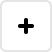
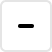
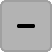
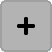
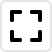
...
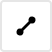
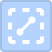
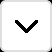
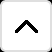
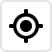

In [2]:
LetsPlot.setup_html()

## 1. Random Sampling

Random sampling selects data points at randomly chosen indices without replacement.

In [3]:
def data1(n, seed=123):
    np.random.seed(seed)
    cov = [[1, -.8], 
           [-.8, 1]]
    x, y = np.random.multivariate_normal(mean=[0, 0], cov=cov, size=n).T
    return dict(x=x, y=y)

Let's set the size of data (n) that exceeds the default sampling threshold for points (100,000).

In [4]:
ggplot(data1(105000), aes('x', 'y')) + geom_point(alpha=.3)

You can change the random sample size.

In [5]:
ggplot(data1(75000), aes('x', 'y')) + geom_point(sampling=sampling_random(500, seed=42))

If you use wrong sampling, for example group random sampling for geom_point(), it will do nothing in this context.  
It will override the default random sampling and effectively disable proper sampling in this plot. 

However, if the data size (n) will grow above the safety threshold (200,000), safety sampling will be applied.

In [6]:
ggplot(data1(105000), aes('x', 'y')) + geom_point(alpha=.3, sampling=sampling_group_random(1, seed=42))

Let's try the data size (n) that exceeds the safety threshold (200,000). 

In [7]:
ggplot(data1(200001), aes('x', 'y')) + geom_point(alpha=.3, sampling=sampling_group_random(1, seed=42))

## 2. Systematic Sampling

Systematic sampling selects data points at evenly distributed indices. Unlike canonical systematic sampling,   
it starts at index 0 and chooses the step so that the last selected index be as close as possible to the last index in the data.

Linear regression is computed using the entire data therefore it is same on all plots regardless the sampling applied to `line` layer.

In [8]:
ggplot(data1(10000), aes('x', 'y')) + geom_line() + geom_smooth(seed=42)

In [9]:
ggplot(data1(10000), aes('x', 'y')) + geom_line(sampling=sampling_systematic(80)) + geom_smooth(seed=42)

## 3. Pick Sampling

Pick sampling is intended mostly for bar chart and it doesn’t pick indices. Instead, it analyses X-values   
and selects all points which X-value is in the set of first n X-values found in the population.

In [10]:
def data2(n, words_count, word_length=5, seed=42):
    np.random.seed(seed)

    words = []
    while len(words) < n:
        word = ''.join(np.random.choice(list(ascii_lowercase), word_length))
        if word not in words:
            words.append(word)

    return dict(
        word=np.random.choice(list(words), n),
        g=np.random.choice(['a', 'b', 'c'], n),
    )

In [11]:
p2 = ggplot(data2(1000, 500), aes(x='word'))

In [12]:
p2 + geom_bar(size=0)

Let's draw bar chart with `pick` sampling.

In [13]:
p2 + geom_bar(sampling=sampling_pick(50), size=0)

`pick` sampling preserves groups on bar chart.

In [14]:
p2 + geom_bar(aes(fill='g'), sampling=sampling_pick(50), size=0)

You can also order words by `count`.

In [15]:
p2 + geom_bar(aes(x=as_discrete('word', order_by='..count..'), fill='g'),
              sampling=sampling_pick(50), size=0)

## 4. Group-aware Sampling
In large dataset with groups, choice of the sampling method may depend on the number of groups and the group size. 

In this example we consider line plot where each line correspons to a group.

In [16]:
def data3(n_per_line, n_groups):
    x_step = 2 * np.pi / (n_per_line - 1)
    little_delta = x_step / 100
    x_stops = np.arange(-np.pi, np.pi + little_delta, x_step)

    y_min, y_max = 1, 10
    y_step = (y_max - y_min) / (n_groups - 1)
    little_delta = y_step / 100
    y_multiplier = np.arange(y_min, y_max + little_delta, y_step)

    x = []
    y = []
    c = []
    for i in range(n_groups):
        x.extend(x_stops)
        y.extend([np.sin(x) * y_multiplier[i] for x in x_stops])
        c.extend([str(i) for _ in x_stops])

    return dict(x=x, y=y, cond=c)

In [17]:
p3 = ggplot(mapping=aes('x','y', color='cond'))

### 4.1. Data With Large Number of Points per Group but Small Number of Groups

The default `systematic` sampling is fine in this case.

In [18]:
p3 + geom_line(data=data3(1000, 10))

### 4.2. Data with Small Number of Points per Group but Large Number of Groups

Systematic line sampling doesn't work very well in this case.

In [19]:
p3 + geom_line(data=data3(30, 1000))

Random group sampling works better.

In [20]:
p3 + geom_line(data=data3(30, 1000), sampling=sampling_group_random(10, seed=42))

Systematic group sampling works even better.

In [21]:
p3 + geom_line(data=data3(30, 1000), sampling=sampling_group_systematic(10))

### 4.3. Data with Large Number of Points per Group and Large Number of Groups

In [22]:
p3 + geom_line(data=data3(1000, 200))

In this case a combination of systematic and group systematic sampling works.

In [23]:
p3 + geom_line(data=data3(1000, 200), sampling=sampling_group_systematic(10) + sampling_systematic(200))

## 5. Stratified Sampling

In large dataset a relatively small group of points might be overplotted by the dominant group. In this case `stratified` sampling can help.

In [24]:
def data4(n, small_group_size, seed=123):
    np.random.seed(seed)
    large_group = n - small_group_size
    return dict(
        x=np.random.normal(0, 1, n),
        y=np.random.normal(0, 1, n),
        cond=['A' for _ in range(small_group_size)] + ['B' for _ in range(large_group)],
    )

Data points in group 'A' (small group) are overplotted by the dominant group 'B'.

In [25]:
p4 = ggplot(data4(5_000, 3), aes('x', 'y', color='cond')) + \
    scale_color_manual(values=['red', '#1C9E77'], breaks=['A', 'B'])
p4 + geom_point(size=5, alpha=.2)

The `random` sampling loses the group 'A'.

In [26]:
p4 + geom_point(size=5, sampling=sampling_random(50, seed=2))

`stratified` sampling ensures that group 'A' is represented.

In [27]:
p4 + geom_point(size=5, sampling=sampling_random_stratified(50, seed=2))

## 6. Vertex Sampling

`vertex` sampling is designed for polygon simplification.
There is a choice of two implementation algorithms: **Douglas-Peucker** and **Visvalingam-Whyatt**.

In [28]:
def data5(n):
    f = lambda x, y: (np.sin(x * 3 * np.pi / n)
                      + np.sin(y * 3 * np.pi / n)
                      + x * 3 / n
                      + y * 5 / n)
    x = np.arange(n)
    y = np.arange(n)
    X, Y = np.meshgrid(x, y)
    Z = f(X, Y)
    return dict(
        x=X.reshape(-1),
        y=Y.reshape(-1),
        z=Z.reshape(-1),
    )

In [29]:
p5 = ggplot(data5(50), aes('x', 'y', z='z')) + theme_void() + ggsize(200, 200)
p5 + geom_contour()

Douglas-Peucker algorithm in this case works better than others. The lines become ragged but the shape remained unchanged.

In [30]:
p5 + geom_contour(sampling=sampling_vertex_dp(200))

Visvalingam-Whyatt algorithm is less accurate with rings: they became unclosed.

In [31]:
p5 + geom_contour(sampling=sampling_vertex_vw(200))

## 7. Option to Show/Hide Plot Messages

The option `plot_message` allows to hide messages produced by sampling.

In [32]:
p5 + geom_contour(sampling=sampling_vertex_vw(200)) + theme(plot_message='blank')

Using the `LestPlot.set_theme(...)` function messages can be suppressed for the whole notebook.

In [33]:
LetsPlot.set_theme(theme_void() + theme(plot_message='blank'))

In [34]:
ggplot(data5(50), aes('x','y', z='z')) + geom_contour(sampling=sampling_vertex_vw(200)) + ggsize(200, 200)